In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from tqdm import tqdm
import zarr
import time
import netCDF4 as nc
import h5py
import scipy

In [2]:
YG = np.load('inputs/ref/YG.npy')
XG = np.load('inputs/ref/XG.npy')
YC = np.load('inputs/ref/YC.npy')
XC = np.load('inputs/ref/XC.npy')
RF = np.load('inputs/ref/RF.npy')

IMF = nc.Dataset('/data/SO2/SO24/ANDY/SOHI/Data/Models/SOHI/2D/2D_2005_09C.nc')
y1 = np.argmin(abs(IMF['YG'] - YG[0]))
y2 = np.argmin(abs(IMF['YG'] - YG[-1]))
x1 = np.argmin(abs(IMF['XG'] - XG[0]%360))
x2 = np.argmin(abs(IMF['XG'] - XG[-1]%360))

In [3]:
icedraft = h5py.File('/data/SO2/SO24/ANDY/SOHI/Data/Models/SOHI/meta/ICEDRAFT_v8.mat')
icedraft = icedraft['Ice_Map'][y1:y2+1,x1:x2+1]

grid = h5py.File('/data/SO2/SO24/ANDY/SOHI/Data/Models/SOHI/meta/GRID_v8.mat')
bath = -grid['Depth'][:]
bath = bath[y1:y2+1,x1:x2+1] + icedraft
bath[bath==0] = np.nan
bath[bath<-2000] = np.nan

# Off-shelf Location

In [4]:
def load_value_atbound(path, CS, maxtime = None, mintime=None):
    CS = np.load(CS)
    flags = np.zeros(len(CS))
    flags[~np.isnan(CS)] = 1
    n = np.count_nonzero(flags==1)
    
    assert len(flags) == len(CS)
    
    if maxtime is not None:
        flags[CS > maxtime] = 0
    if mintime is not None:
        flags[CS < mintime] = 0
    
    data = zarr.open(path, mode='r')
    
    res = [[],[]]
    
    var = ['lon', 'z']
    for v in range(len(var)):
        print(f"Loading data...")
        t1 = time.time()
        field = np.asarray(data[var[v]])
        print(f"Loaded in {int((time.time()-t1)/60)} m")
        for p in range(len(CS)):
            if flags[p] ==1:
                index = int(CS[p])
                res[v].append(field[p, index])
            
    return np.asarray(res)

## Location where particles cross continental shelf

In [5]:
pineisland_X0, pineisland_Z0 = load_value_atbound(path = 'outputs/R8_ASE_5min/pineisland.zarr', 
                                                CS = 'processed_dataGL/pineisland_0d_CS.npy',
                                               maxtime=365, mintime=0)

pineisland_X1, pineisland_Z1 = load_value_atbound(path = 'outputs/R8_ASE_5min/pineisland.zarr', 
                                                CS = 'processed_dataGL/pineisland_0d_CS.npy',
                                               maxtime=730, mintime=365)

pineisland_X2, pineisland_Z2 = load_value_atbound(path = 'outputs/R8_ASE_5min/pineisland.zarr', 
                                                CS = 'processed_dataGL/pineisland_0d_CS.npy',
                                               maxtime=1095, mintime=730)

thwaites_X0, thwaites_Z0 = load_value_atbound(path = 'outputs/R8_ASE_5min/thwaites.zarr', 
                                                CS = 'processed_dataGL/thwaites_0d_CS.npy',
                                               maxtime=365, mintime=0)

thwaites_X1, thwaites_Z1 = load_value_atbound(path = 'outputs/R8_ASE_5min/thwaites.zarr', 
                                                CS = 'processed_dataGL/thwaites_0d_CS.npy',
                                               maxtime=730, mintime=365)

thwaites_X2, thwaites_Z2 = load_value_atbound(path = 'outputs/R8_ASE_5min/thwaites.zarr', 
                                                CS = 'processed_dataGL/thwaites_0d_CS.npy',
                                               maxtime=1095, mintime=730)

smith_X0, smith_Z0 = load_value_atbound(path = 'outputs/R8_ASE_5min/smith.zarr', 
                                                CS = 'processed_dataGL/smith_0d_CS.npy',
                                               maxtime=365, mintime=0)

smith_X1, smith_Z1 = load_value_atbound(path = 'outputs/R8_ASE_5min/smith.zarr', 
                                                CS = 'processed_dataGL/smith_0d_CS.npy',
                                               maxtime=730, mintime=365)

smith_X2, smith_Z2 = load_value_atbound(path = 'outputs/R8_ASE_5min/smith.zarr', 
                                                CS = 'processed_dataGL/smith_0d_CS.npy',
                                               maxtime=1095, mintime=730)

kohler_X0, kohler_Z0 = load_value_atbound(path = 'outputs/R8_ASE_5min/kohler.zarr', 
                                                CS = 'processed_dataGL/kohler_0d_CS.npy',
                                               maxtime=365, mintime=0)

kohler_X1, kohler_Z1 = load_value_atbound(path = 'outputs/R8_ASE_5min/kohler.zarr', 
                                                CS = 'processed_dataGL/kohler_0d_CS.npy',
                                               maxtime=730, mintime=365)

kohler_X2, kohler_Z2 = load_value_atbound(path = 'outputs/R8_ASE_5min/kohler.zarr', 
                                                CS = 'processed_dataGL/kohler_0d_CS.npy',
                                               maxtime=1095, mintime=730)

Loading data...
Loaded in 2 m
Loading data...
Loaded in 2 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 1 m
Loading data...
Loaded in 1 m
Loading data...
Loaded in 2 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 1 m
Loading data...
Loaded in 2 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 0 m
Loading data...
Loaded in 0 m


In [6]:
def d(data):
    X, _ = np.histogram(data, np.arange(-130, -75, 0.05))
    res = scipy.ndimage.gaussian_filter(X, sigma=2, truncate=5)
    #res = X
    return res/np.sum(res)

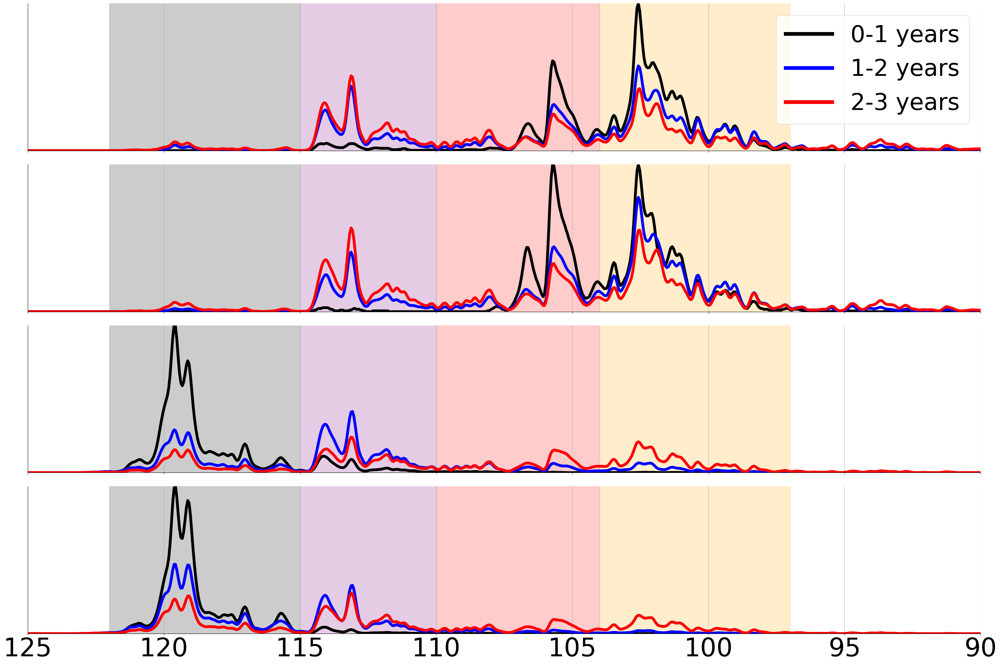

In [141]:
fig, ax = plt.subplots(figsize=(30,20), nrows=4, sharex=True)

X = np.arange(-129.975, -75.025, 0.05)
lw = 6

ax[0].plot(X, d(pineisland_X0), c='black', label='0-1 years', lw=lw)
ax[0].plot(X, d(pineisland_X1), c= 'blue', label='1-2 years', lw=lw)
ax[0].plot(X, d(pineisland_X2), c = 'red', label = '2-3 years', lw=lw)

ax[1].plot(X, d(thwaites_X0), c='black', label='1 year', lw=lw)
ax[1].plot(X, d(thwaites_X1), c= 'blue', label='2 years', lw=lw)
ax[1].plot(X, d(thwaites_X2), c = 'red', label = '3 years', lw=lw)

ax[2].plot(X, d(smith_X0), c='black', label='1 year', lw=lw)
ax[2].plot(X, d(smith_X1), c= 'blue', label='2 years', lw=lw)
ax[2].plot(X, d(smith_X2), c = 'red', label = '3 years', lw=lw)

ax[3].plot(X, d(kohler_X0), c='black', label='1 year', lw=lw)
ax[3].plot(X, d(kohler_X1), c= 'blue', label='2 years', lw=lw)
ax[3].plot(X, d(kohler_X2), c = 'red', label = '3 years', lw=lw)

leg = ax[0].legend(fontsize=50, loc='upper right')

for line in leg.get_lines():
    line.set_linewidth(8)
    
for a in ax.flat:
    a.tick_params(axis='both', labelsize=55)
    a.grid()
    a.set_xlim(-125, -90)
    a.spines['right'].set_color('none')
    a.spines['top'].set_color('none')
    

# m = 0
# n = 3.5
for a in ax.flat:
    
    a.set_yticks([])
    
    a.fill_betweenx([0, 3.5], [-122, -122], [-115, -115], color='k', alpha=0.2)
    a.fill_betweenx([0, 3.5], [-115, -115], [-110, -110], color='purple', alpha=0.2)
    a.fill_betweenx([0, 3.5], [-110, -110], [-104, -104], color='red', alpha=0.2)
    a.fill_betweenx([0, 3.5], [-104, -104], [-97, -97], color='orange', alpha=0.2)
#     a.fill_betweenx([0, 3.5], [-100.75, -100.75], [-97.5, -97.5], color='purple', alpha=0.2)

ax[0].set_ylim(0, np.max(d(pineisland_X0)))
ax[1].set_ylim(0, np.max(d(thwaites_X0)))
ax[2].set_ylim(0, np.max(d(smith_X0)))
ax[3].set_ylim(0, np.max(d(kohler_X0)))


# ax[0].set_ylim(0, 3.5)
# ax[1].set_ylim(0, 3.5)
# ax[2].set_ylim(0, 3.5)
# ax[3].set_ylim(0, 3.5)

# ax[0].set_yticks([1, 2, 3])
# ax[1].set_yticks([1, 2, 3])
# ax[2].set_yticks([1, 2, 3])
# ax[3].set_yticks([1, 2, 3])

ax[3].set_xticks([-125, -120, -115, -110, -105, -100, -95, -90])
ax[3].set_xticklabels([125, 120, 115, 110, 105, 100, 95, 90])


plt.tight_layout()

plt.savefig('img_pathways/LONGITUDE.png', dpi=300)

# Pathways: Heatmap

In [13]:
def heat_map(data_path, IS, CS, East, stucked, bounds, mintime = 0, maxtime = 365):
    ogCS = np.load(CS)
    ogE = np.load(East)
    IS = np.load(IS)
    CS = np.load(CS)
    East = np.load(East)
    stucked = np.load(stucked)
    n = len(bounds) + 2
    
    total_particles = np.count_nonzero(stucked == 0)
    
    data = zarr.open(data_path, mode='r')
    print('Loading I...')
    I = np.asarray(data['I'][:])
    print('Loading J...')
    J = np.asarray(data['J'][:])
    print('Loading lons...')
    lons = np.asarray(data['lon'][:])
    
    IS[IS>365] = np.nan ## Eliminate particles that take longer than 1 yr to exit cavity 
    CS[CS > maxtime] = np.nan
    CS[CS < mintime] = np.nan
    CS[np.isnan(IS)] = np.nan
    
    East[East>maxtime] = np.nan
    East[East<mintime] = np.nan
    East[np.isnan(IS)] = np.nan
    
    esf = np.logical_and(np.isnan(ogCS), ~np.isnan(East))
    ons = np.logical_and(np.isnan(ogCS), np.isnan(ogE))
    
    field = [np.zeros((517, 1800)) for lb in range(n)]
    counts = [0 for _ in range(n)]
    counter = 0
    
    for p in tqdm(range(I.shape[0])):
             
        if ~np.isnan(CS[p]): ## Off-shelf 
            counter += 1
            loc = lons[p, int(CS[p])]
            bindex = None
            for b in range(len(bounds)):
                if loc >= bounds[b][0] and loc < bounds[b][1]:
                    bindex = b
                    break
            if bindex is not None:
                counts[bindex] += 1
                for t in range(int(CS[p])):
                    field[bindex][int(I[p,t]), int(J[p,t])] += 1
                    
        ## East of ASE & not Offshelf
        elif esf[p]: 
            counts[-2] += 1
            for t in range(I.shape[1]): ## Iterate all 
                field[-2][int(I[p,t]), int(J[p,t])] += 1
                
        elif ons[p]:
            counts[-1] += 1
            for t in range(I.shape[1]): ## Iterate all 
                field[-1][int(I[p,t]), int(J[p,t])] += 1

    return field

In [123]:
def cal_std(data_path, IS, CS, East, stucked, bounds, maxtime, mintime):
    CS = np.load(CS)
    IS = np.load(IS)
    East = np.load(East)
    stucked = np.load(stucked)
    
    CS[CS > maxtime] = np.nan
    CS[CS < mintime] = np.nan
    East[East>maxtime] = np.nan
    East[East<mintime] = np.nan
    
    data = zarr.open(data_path, mode='r')
    
    print('Loading lons...')
    lons = np.asarray(data['lon'][:])
    
    ll = []
    for i in range(len(CS)):
        if ~np.isnan(CS[i]):
            ll.append(lons[i, int(CS[i])])
        elif ~np.isnan(East[i]):
            ll.append(0)
        else:
            ll.append(np.nan)
    ll = np.asarray(ll)
    
    n = len(IS)
    n_real = np.count_nonzero(stucked==0)
    print(n_real)
    
    print(n)
    num = int(n/366)
    

    per = [[] for i in range(len(bounds)+1)]
    
    p1index = []
    p2index = []
    p3index = []
    p4index = []
    esindex = []
    
    
    for i in tqdm(range(0, n, num)):
        sL = ll[i:i+num]
        stucked_sub = stucked[i:i+num]
        
        c1 = 0
        c2 = 0
        c3 = 0
        c4 = 0
        c5 = 0
        
        count = 0

        clost = 0
        cn = np.count_nonzero(stucked_sub == 0)
        
        for xloc in sL:
            if ~np.isnan(xloc) and xloc != 0:
                if xloc >= bounds[0][0] and xloc < bounds[0][1]:
                    c1 += 1
                    p1index.append(i + count)
                elif xloc >= bounds[1][0] and xloc < bounds[1][1]:
                    c2 += 1
                    p2index.append(i + count)
                elif xloc >= bounds[2][0] and xloc < bounds[2][1]:
                    c3 += 1
                    p3index.append(i + count)
                elif xloc >= bounds[3][0] and xloc < bounds[3][1]:
                    c4 += 1
                    p4index.append(i + count)
                else:
                    clost += 1
                    
            elif xloc == 0:
                esindex.append(i + count)
                c5 += 1
                       
            count += 1
                
        per[0].append(c1/cn*100)
        per[1].append(c2/cn*100)
        per[2].append(c3/cn*100)
        per[3].append(c4/cn*100)
        per[4].append(c5/cn*100)          

    for s in per:
        print(f"")
        print(f"Mean = {np.mean(s)}")
        print(f"Std = {np.std(s)}")
        
        
    return (p1index, p2index, p3index, p4index, esindex)

# 1 Year


In [16]:
fields = heat_map(data_path = 'outputs/R8_ASE_5min/pineisland.zarr',
                                 IS = 'processed_dataGL/pineisland_0d_IS.npy',
                                 CS = 'processed_dataGL/pineisland_0d_CS.npy',
                                 East = 'processed_dataGL/pineisland_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/pineisland_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 365, mintime=0)

np.save('data_heatmap/pineisland_1yr_maps.npy', fields)

PIG_mask = np.load('inputs/ref/PIG_Mask.npy')
PIG_mask[np.isnan(PIG_mask)] = 0

Loading I...
Loading J...
Loading lons...


100%|█████████████████████████████████| 397476/397476 [02:41<00:00, 2458.77it/s]


In [45]:
pig_index = cal_std(data_path = 'outputs/R8_ASE_5min/pineisland.zarr',
                                 IS = 'processed_dataGL/pineisland_0d_IS.npy',
                                 CS = 'processed_dataGL/pineisland_0d_CS.npy',
                                 East = 'processed_dataGL/pineisland_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/pineisland_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 365, mintime=0)

Loading lons...
397476


100%|████████████████████████████████████████| 366/366 [00:00<00:00, 536.60it/s]


Mean = 0.015659988192251884
Std = 0.17282401899919367

Mean = 4.255405581406441
Std = 5.268337478583633

Mean = 28.25613540123089
Std = 8.020249031545431

Mean = 66.76105916003054
Std = 11.306425652077094

Mean = 0.7117398691398827
Std = 1.0991203910378027


In [18]:
fields = heat_map(data_path = 'outputs/R8_ASE_5min/thwaites.zarr',
                                 IS = 'processed_dataGL/thwaites_0d_IS.npy',
                                 CS = 'processed_dataGL/thwaites_0d_CS.npy',
                                 East = 'processed_dataGL/thwaites_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/thwaites_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 365, mintime=0)

np.save('data_heatmap/thwaites_1yr_maps.npy', fields)

TIS_mask = np.load('inputs/ref/TIS_Mask.npy')
TIS_mask[np.isnan(TIS_mask)] = 0

Loading I...
Loading J...
Loading lons...


100%|█████████████████████████████████| 389790/389790 [02:42<00:00, 2395.56it/s]


In [46]:
thg_index = cal_std(data_path = 'outputs/R8_ASE_5min/thwaites.zarr',
                                 IS = 'processed_dataGL/thwaites_0d_IS.npy',
                                 CS = 'processed_dataGL/thwaites_0d_CS.npy',
                                 East = 'processed_dataGL/thwaites_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/thwaites_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 365, mintime=0)

Loading lons...
389790


100%|████████████████████████████████████████| 366/366 [00:00<00:00, 549.39it/s]


Mean = 0.0
Std = 0.0

Mean = 1.226849729272955
Std = 2.3965676447900197

Mean = 38.117999199497625
Std = 14.589065231047934

Mean = 59.863645989361075
Std = 15.112612420635715

Mean = 0.7915050818683353
Std = 1.9117787752036384


In [20]:
fields = heat_map(data_path = 'outputs/R8_ASE_5min/smith.zarr',
                                 IS = 'processed_dataGL/smith_0d_IS.npy',
                                 CS = 'processed_dataGL/smith_0d_CS.npy',
                                 East = 'processed_dataGL/smith_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/smith_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 365, mintime=0)

np.save('data_heatmap/smith_1yr_maps.npy', fields)

CSN_mask = np.load('inputs/ref/CSN_Mask.npy')
CSN_mask[np.isnan(CSN_mask)] = 0

Loading I...
Loading J...
Loading lons...


100%|█████████████████████████████████| 376980/376980 [03:07<00:00, 2014.96it/s]


In [47]:
smt_index = cal_std(data_path = 'outputs/R8_ASE_5min/smith.zarr',
                                 IS = 'processed_dataGL/smith_0d_IS.npy',
                                 CS = 'processed_dataGL/smith_0d_CS.npy',
                                 East = 'processed_dataGL/smith_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/smith_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 365, mintime=0)

Loading lons...
376980


100%|████████████████████████████████████████| 366/366 [00:00<00:00, 565.83it/s]


Mean = 87.02747560959081
Std = 6.012014499053093

Mean = 11.238253668685775
Std = 5.899895023184853

Mean = 1.185373412748089
Std = 1.3052256051479236

Mean = 0.3801351745565364
Std = 0.6862965844327751

Mean = 0.16876213441877763
Std = 0.40723133099782804


In [22]:
fields = heat_map(data_path = 'outputs/R8_ASE_5min/kohler.zarr',
                                 IS = 'processed_dataGL/kohler_0d_IS.npy',
                                 CS = 'processed_dataGL/kohler_0d_CS.npy',
                                 East = 'processed_dataGL/kohler_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/kohler_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 365, mintime = 0)

np.save('data_heatmap/kohler_1yr_maps.npy', fields)

Loading I...
Loading J...
Loading lons...


100%|█████████████████████████████████| 365268/365268 [02:41<00:00, 2262.54it/s]


In [48]:
khl_index = cal_std(data_path = 'outputs/R8_ASE_5min/kohler.zarr',
                                 IS = 'processed_dataGL/kohler_0d_IS.npy',
                                 CS = 'processed_dataGL/kohler_0d_CS.npy',
                                 East = 'processed_dataGL/kohler_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/kohler_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 365, mintime = 0)

Loading lons...
365268


100%|████████████████████████████████████████| 366/366 [00:00<00:00, 582.07it/s]


Mean = 95.34513156939443
Std = 2.318627818672878

Mean = 4.128444167441101
Std = 2.2169911926244286

Mean = 0.359772066834164
Std = 0.5573564928877709

Mean = 0.06402485784080449
Std = 0.22171207264732773

Mean = 0.10262733848950965
Std = 0.2723367392834397


### Make off-shelf mask

In [24]:
oce_mask = np.load('inputs/ref/700m_isobath_v2.npy')

In [25]:
oce_mask[oce_mask==0] = np.nan
oce_mask[~np.isnan(oce_mask)] = 1

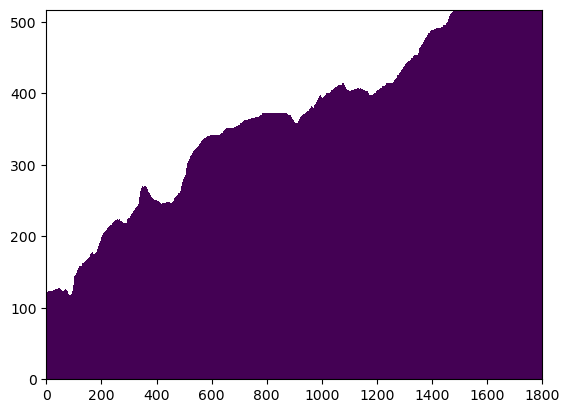

In [26]:
plt.pcolormesh(oce_mask)

# 3 Years

In [30]:
fields = heat_map(data_path = 'outputs/R8_ASE_5min/pineisland.zarr',
                                 IS = 'processed_dataGL/pineisland_0d_IS.npy',
                                 CS = 'processed_dataGL/pineisland_0d_CS.npy',
                                 East = 'processed_dataGL/pineisland_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/pineisland_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 1095, mintime=0)

np.save('data_heatmap/pineisland_3yr_maps.npy', fields)

PIG_mask = np.load('inputs/ref/PIG_Mask.npy')
PIG_mask[np.isnan(PIG_mask)] = 0

Loading I...
Loading J...
Loading lons...


100%|█████████████████████████████████| 397476/397476 [04:21<00:00, 1522.26it/s]


In [124]:
pig_index = cal_std(data_path = 'outputs/R8_ASE_5min/pineisland.zarr',
                                 IS = 'processed_dataGL/pineisland_0d_IS.npy',
                                 CS = 'processed_dataGL/pineisland_0d_CS.npy',
                                 East = 'processed_dataGL/pineisland_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/pineisland_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 1095, mintime=0)

Loading lons...
333919
397476


100%|████████████████████████████████████████| 366/366 [00:00<00:00, 489.29it/s]


Mean = 0.9689285571488065
Std = 0.32233258563067807

Mean = 8.587068184264485
Std = 1.5832341069162552

Mean = 8.321999253684977
Std = 1.0772197307834666

Mean = 17.762049327584627
Std = 1.7549099298797302

Mean = 25.709922997478365
Std = 2.1882767389900346


In [32]:
fields = heat_map(data_path = 'outputs/R8_ASE_5min/thwaites.zarr',
                                 IS = 'processed_dataGL/thwaites_0d_IS.npy',
                                 CS = 'processed_dataGL/thwaites_0d_CS.npy',
                                 East = 'processed_dataGL/thwaites_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/thwaites_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 1095, mintime=0)

np.save('data_heatmap/thwaites_3yr_maps.npy', fields)

TIS_mask = np.load('inputs/ref/TIS_Mask.npy')
TIS_mask[np.isnan(TIS_mask)] = 0

Loading I...
Loading J...
Loading lons...


100%|█████████████████████████████████| 389790/389790 [04:24<00:00, 1475.79it/s]


In [125]:
thg_index = cal_std(data_path = 'outputs/R8_ASE_5min/thwaites.zarr',
                                 IS = 'processed_dataGL/thwaites_0d_IS.npy',
                                 CS = 'processed_dataGL/thwaites_0d_CS.npy',
                                 East = 'processed_dataGL/thwaites_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/thwaites_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 1095, mintime=0)

Loading lons...
347104
389790


100%|████████████████████████████████████████| 366/366 [00:00<00:00, 496.64it/s]


Mean = 0.7279087404525758
Std = 0.28742174234092055

Mean = 6.827817995467491
Std = 1.3445999833461093

Mean = 7.92389999512655
Std = 1.2363732007705133

Mean = 15.58568240378303
Std = 1.422760972362873

Mean = 22.603837601338814
Std = 1.6274033932874146


In [34]:
fields = heat_map(data_path = 'outputs/R8_ASE_5min/smith.zarr',
                                 IS = 'processed_dataGL/smith_0d_IS.npy',
                                 CS = 'processed_dataGL/smith_0d_CS.npy',
                                 East = 'processed_dataGL/smith_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/smith_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 1095, mintime=0)

np.save('data_heatmap/smith_3yr_maps.npy', fields)

CSN_mask = np.load('inputs/ref/CSN_Mask.npy')
CSN_mask[np.isnan(CSN_mask)] = 0

Loading I...
Loading J...
Loading lons...


100%|█████████████████████████████████| 376980/376980 [04:02<00:00, 1554.99it/s]


In [126]:
smt_index = cal_std(data_path = 'outputs/R8_ASE_5min/smith.zarr',
                                 IS = 'processed_dataGL/smith_0d_IS.npy',
                                 CS = 'processed_dataGL/smith_0d_CS.npy',
                                 East = 'processed_dataGL/smith_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/smith_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 1095, mintime=0)

Loading lons...
301869
376980


100%|████████████████████████████████████████| 366/366 [00:00<00:00, 524.53it/s]


Mean = 17.704630965513115
Std = 2.97152202501386

Mean = 10.7133560657887
Std = 1.8411542742432179

Mean = 4.324343279297765
Std = 0.7100848840608269

Mean = 4.789959129986173
Std = 0.90190021811931

Mean = 8.756743644737439
Std = 1.2452381034801772


In [36]:
fields = heat_map(data_path = 'outputs/R8_ASE_5min/kohler.zarr',
                                 IS = 'processed_dataGL/kohler_0d_IS.npy',
                                 CS = 'processed_dataGL/kohler_0d_CS.npy',
                                 East = 'processed_dataGL/kohler_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/kohler_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 1095, mintime = 0)

np.save('data_heatmap/kohler_3yr_maps.npy', fields)

Loading I...
Loading J...
Loading lons...


100%|█████████████████████████████████| 365268/365268 [03:37<00:00, 1677.87it/s]


In [127]:
khl_index = cal_std(data_path = 'outputs/R8_ASE_5min/kohler.zarr',
                                 IS = 'processed_dataGL/kohler_0d_IS.npy',
                                 CS = 'processed_dataGL/kohler_0d_CS.npy',
                                 East = 'processed_dataGL/kohler_0d_Eastern.npy',
                                 stucked = 'processed_dataGL/kohler_0d_Stucked.npy',
                                bounds=[[-122, -115]  , [-115, -110]   , 
                                        [-110, -104], [-104, -97]],
                                 maxtime = 1095, mintime = 0)

Loading lons...
309757
365268


100%|████████████████████████████████████████| 366/366 [00:00<00:00, 545.41it/s]


Mean = 31.596328224064187
Std = 3.4817022209009933

Mean = 10.27458029455623
Std = 1.246329365663781

Mean = 2.968278905126488
Std = 0.6335720428877814

Mean = 2.866637692438077
Std = 0.7353896479528771

Mean = 5.384945484280618
Std = 1.071436294865788


In [34]:
hm1 = np.load('data_heatmap/pineisland_3yr_maps.npy')
hm2 = np.load('data_heatmap/thwaites_3yr_maps.npy')
hm3 = np.load('data_heatmap/smith_3yr_maps.npy')
hm4 = np.load('data_heatmap/kohler_3yr_maps.npy')

In [128]:
def get_coords(zarr_path, ES, CS, index):
    
    CS = np.load(CS)
    ES = np.load(ES)

    source = zarr.open(zarr_path, 'r')
    print('Loading lon...')
    lons = source['lon'][:]
    print('Loading lat...')
    lats = source['lat'][:]
    print('Getting data...')

    longitudes = []
    latitudes = []
    
    for i in range(5):
        extracted_CS = []
        
        if i != 4:
            for j in range(len(index[i])):
                extracted_CS.append(CS[int(index[i][j])])
        else:
            for j in range(len(index[i])):
                extracted_CS.append(ES[int(index[i][j])])
            
        assert len(extracted_CS) > 1000
        
        extracted_CS = np.asarray(extracted_CS)
        
        ix = np.argsort(extracted_CS)
        extracted_CS = extracted_CS[ix]
        extracted_CS = extracted_CS[:1000]
        
        indices = np.asarray(index[i])
        indices = indices[ix]
        indices = indices[:1000]
        
        lon_hold = []
        lat_hold = []
        
        for j in range(1000):
            p = int(indices[j])
            t = int(extracted_CS[j])
            
            if i != 4:
                lat_hold.append(lats[p,:t])
                lon_hold.append(lons[p,:t])
            else:
                lat_hold.append(lats[p,:])
                lon_hold.append(lons[p,:])
            
        longitudes.append(lon_hold)
        latitudes.append(lat_hold)
        

    return longitudes, latitudes


In [101]:
len(khl_index[4])

16680

In [129]:
X1, Y1 = get_coords(zarr_path = 'outputs/R8_ASE_5min/pineisland.zarr',
          ES = 'processed_dataGL/pineisland_0d_Eastern.npy',
          CS = 'processed_dataGL/pineisland_0d_CS.npy',
          index = pig_index)

Loading lon...
Loading lat...
Getting data...


In [130]:
X2, Y2 = get_coords(zarr_path = 'outputs/R8_ASE_5min/thwaites.zarr',
          ES = 'processed_dataGL/thwaites_0d_Eastern.npy',
          CS = 'processed_dataGL/thwaites_0d_CS.npy',
          index = thg_index)

Loading lon...
Loading lat...
Getting data...


In [131]:
X3, Y3 = get_coords(zarr_path = 'outputs/R8_ASE_5min/smith.zarr',
          ES = 'processed_dataGL/smith_0d_Eastern.npy',
          CS = 'processed_dataGL/smith_0d_CS.npy',
          index = smt_index)

Loading lon...
Loading lat...
Getting data...


In [132]:
X4, Y4 = get_coords(zarr_path = 'outputs/R8_ASE_5min/kohler.zarr',
          ES = 'processed_dataGL/kohler_0d_Eastern.npy',
          CS = 'processed_dataGL/kohler_0d_CS.npy',
          index = khl_index)

Loading lon...
Loading lat...
Getting data...


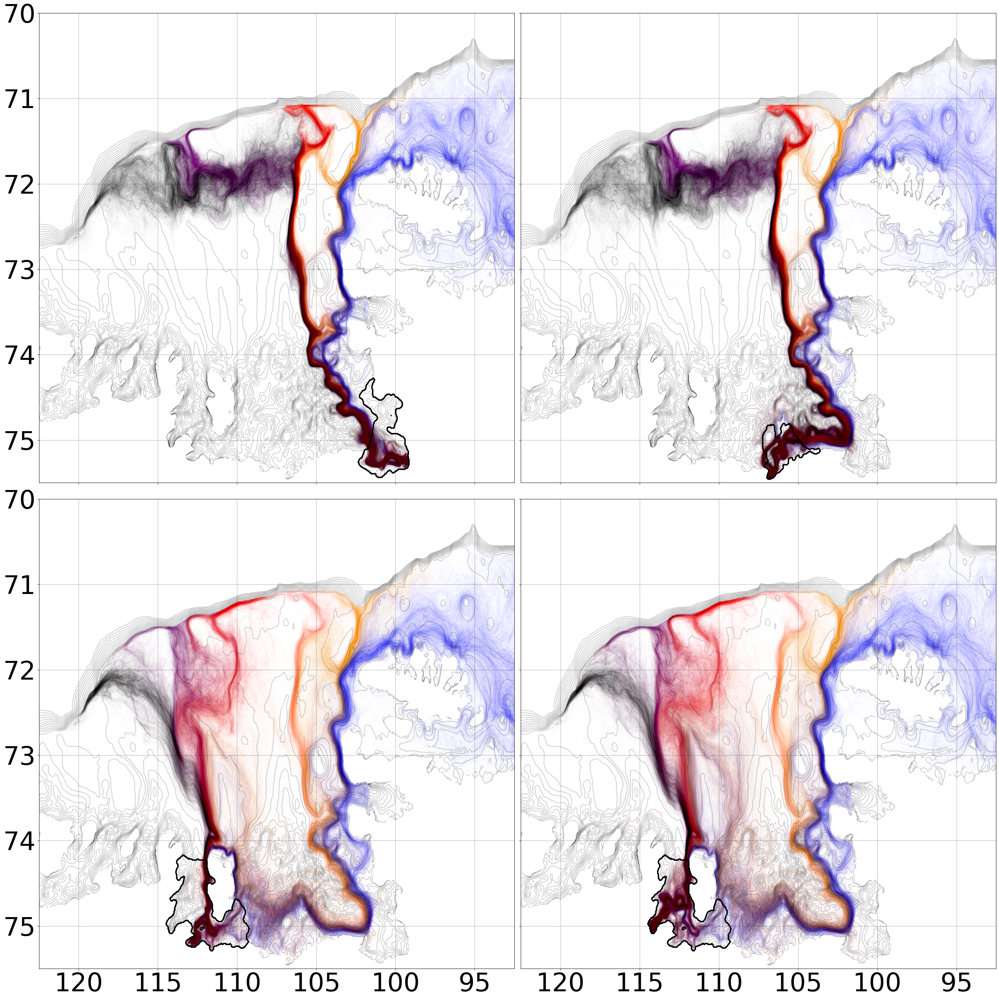

In [143]:
alpha = 0.01



fig, ax = plt.subplots(figsize=(30,30), nrows=2, ncols=2, sharex=True, sharey=True)

for ll in range(1000):
    ax[0,0].plot(X1[0][ll], Y1[0][ll], c='k', alpha=alpha)
    ax[0,0].plot(X1[1][ll], Y1[1][ll], c='purple', alpha=alpha)
    ax[0,0].plot(X1[2][ll], Y1[2][ll], c='red', alpha=alpha)
    ax[0,0].plot(X1[4][ll], Y1[4][ll], c='blue', alpha=alpha)
    ax[0,0].plot(X1[3][ll], Y1[3][ll], c='orange', alpha=alpha)
    
    
for ll in range(1000):
    ax[0,1].plot(X2[0][ll], Y2[0][ll], c='k', alpha=alpha)
    ax[0,1].plot(X2[1][ll], Y2[1][ll], c='purple', alpha=alpha)
    ax[0,1].plot(X2[2][ll], Y2[2][ll], c='red', alpha=alpha)
    ax[0,1].plot(X2[4][ll], Y2[4][ll], c='blue', alpha=alpha)
    ax[0,1].plot(X2[3][ll], Y2[3][ll], c='orange', alpha=alpha)
    
for ll in range(1000):
    ax[1,0].plot(X3[0][ll], Y3[0][ll], c='k', alpha=alpha)
    ax[1,0].plot(X3[1][ll], Y3[1][ll], c='purple', alpha=alpha)
    ax[1,0].plot(X3[2][ll], Y3[2][ll], c='red', alpha=alpha)
    ax[1,0].plot(X3[4][ll], Y3[4][ll], c='blue', alpha=alpha)
    ax[1,0].plot(X3[3][ll], Y3[3][ll], c='orange', alpha=alpha)
    
for ll in range(1000):
    ax[1,1].plot(X4[0][ll], Y4[0][ll], c='k', alpha=alpha)
    ax[1,1].plot(X4[1][ll], Y4[1][ll], c='purple', alpha=alpha)
    ax[1,1].plot(X4[2][ll], Y4[2][ll], c='red', alpha=alpha)
    ax[1,1].plot(X4[4][ll], Y4[4][ll], c='blue', alpha=alpha)
    ax[1,1].plot(X4[3][ll], Y4[3][ll], c='orange', alpha=alpha)
    
ax[0,0].contour(XC, YC, PIG_mask, levels=[0,1], colors=['k'], linewidths=3)
ax[0,1].contour(XC, YC, TIS_mask, levels=[0,1], colors=['k'], linewidths=3)
ax[1,0].contour(XC, YC, CSN_mask, levels=[0,1], colors=['k'], linewidths=3)
ax[1,1].contour(XC, YC, CSN_mask, levels=[0,1], colors=['k'], linewidths=3)


for a in ax.flat:
    a.contour(XC, YC, bath, levels=np.arange(-1600, 0, 100), colors=['k'], linestyles='solid', alpha=0.2)
    
    a.set_xlim(-122.5, -92.5)
    a.set_ylim(-75.5, -70)
    
    a.set_xticks([-120, -115, -110, -105, -100, -95])
    a.set_xticklabels([120, 115, 110, 105, 100, 95])
    
    a.set_yticks([-75, -74, -73, -72, -71, -70])
    a.set_yticklabels([75, 74, 73, 72, 71, 70])
    
#     a.plot([-122, -122], [-75, -70], color='k')
#     a.plot([-115, -115], [-75, -70], color='k')
#     a.plot([-110, -110], [-75, -70], color='k')
#     a.plot([-104, -104], [-75, -70], color='k')
#     a.plot([-97, -97], [-75, -70], color='k')
        
    a.tick_params(axis='both', labelsize=55)
    a.grid()

plt.tight_layout()

plt.savefig('img_pathways/1K.png', dpi=300)

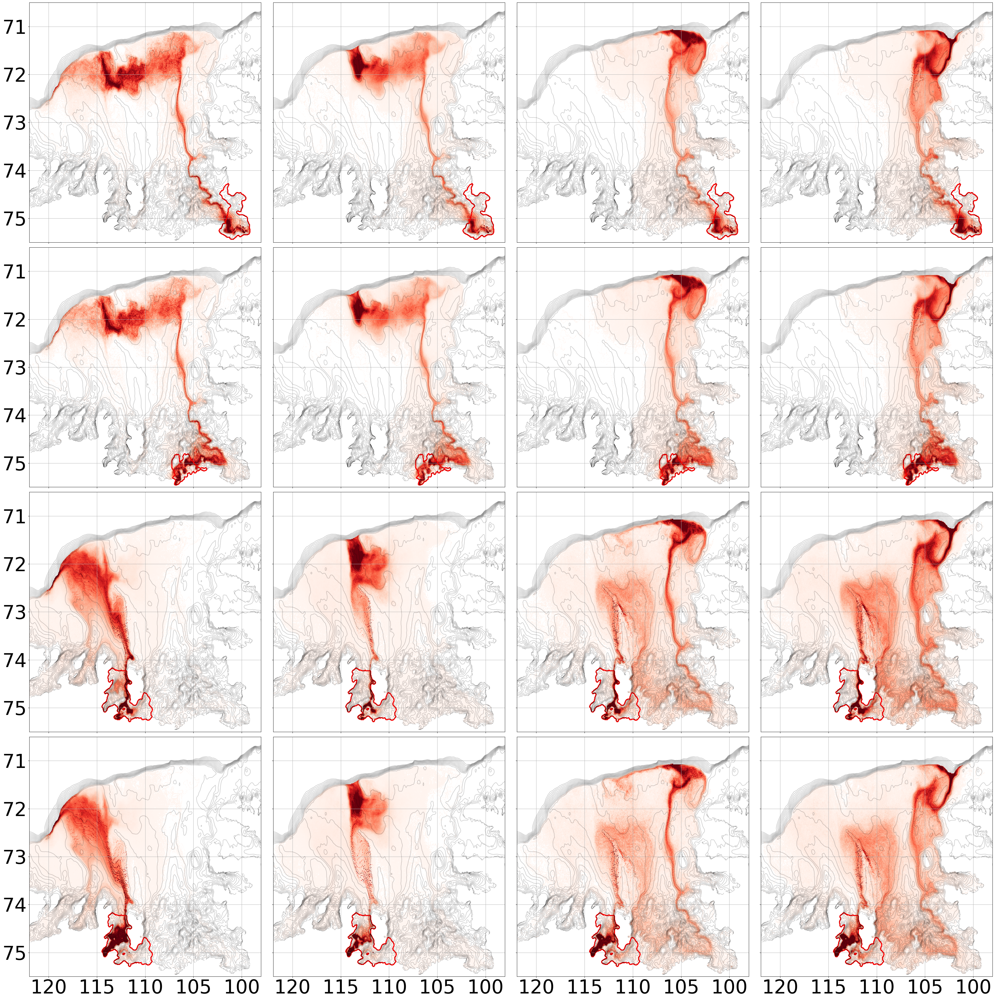

In [38]:
fig, ax = plt.subplots(figsize=(40, 40), nrows=4, ncols=4, sharex=True, sharey=True)

data = hm1[0] * oce_mask
data[data<1] = np.nan
ax[0,0].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm1[1] * oce_mask
data[data<1] = np.nan
ax[0,1].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm1[2] * oce_mask
data[data<1] = np.nan
ax[0,2].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm1[3] * oce_mask
data[data<1] = np.nan
ax[0,3].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

# ###


data = hm2[0] * oce_mask
data[data<1] = np.nan
ax[1,0].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm2[1] * oce_mask
data[data<1] = np.nan
ax[1,1].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm2[2] * oce_mask
data[data<1] = np.nan
ax[1,2].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm2[3] * oce_mask
data[data<1] = np.nan
ax[1,3].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

###

data = hm3[0] * oce_mask
data[data<1] = np.nan
ax[2,0].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm3[1] * oce_mask
data[data<1] = np.nan
ax[2,1].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm3[2] * oce_mask
data[data<1] = np.nan
ax[2,2].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm3[3] * oce_mask
data[data<1] = np.nan
ax[2,3].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

## 

data = hm4[0] * oce_mask
data[data<1] = np.nan
ax[3,0].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,98),2]), cmap = cmap)

data = hm4[1] * oce_mask
data[data<1] = np.nan
ax[3,1].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm4[2] * oce_mask
data[data<1] = np.nan
ax[3,2].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)

data = hm4[3] * oce_mask
data[data<1] = np.nan
ax[3,3].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,99),2]), cmap = cmap)


ax[0,0].contour(XC, YC, PIG_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[0,1].contour(XC, YC, PIG_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[0,2].contour(XC, YC, PIG_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[0,3].contour(XC, YC, PIG_mask, levels=[0,1], colors=['red'], linewidths=3)

ax[1,0].contour(XC, YC, TIS_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[1,1].contour(XC, YC, TIS_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[1,2].contour(XC, YC, TIS_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[1,3].contour(XC, YC, TIS_mask, levels=[0,1], colors=['red'], linewidths=3)

ax[2,0].contour(XC, YC, CSN_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[2,1].contour(XC, YC, CSN_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[2,2].contour(XC, YC, CSN_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[2,3].contour(XC, YC, CSN_mask, levels=[0,1], colors=['red'], linewidths=3)


ax[3,0].contour(XC, YC, CSN_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[3,1].contour(XC, YC, CSN_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[3,2].contour(XC, YC, CSN_mask, levels=[0,1], colors=['red'], linewidths=3)
ax[3,3].contour(XC, YC, CSN_mask, levels=[0,1], colors=['red'], linewidths=3)

for a in ax.flat:
    a.contour(XC, YC, bath, levels=np.arange(-1600, 0, 100), colors=['k'], linestyles='solid', alpha=0.2)
    
    a.set_xlim(-122, -98)
    a.set_ylim(-75.5, -70.5)
    
    a.set_xticks([-120, -115, -110, -105, -100])
    a.set_xticklabels([120, 115, 110, 105, 100])
    
    a.set_yticks([-75, -74, -73, -72, -71])
    a.set_yticklabels([75, 74, 73, 72, 71])
        
    a.tick_params(axis='both', labelsize=55)
    a.grid()
    
plt.tight_layout()

plt.savefig('img_pathways/3yearsSum.png', dpi=300)

### On-shelf Water

In [39]:
def get_index(CS, IS, East):
    CS = np.load(CS)
    IS = np.load(IS)
    East = np.load(East)
    
    f1 = np.zeros(len(CS))
    f2 = np.zeros(len(CS))
    
    for i in range(len(CS)):
        if np.isnan(CS[i]) and np.isnan(East[i]):
            f1[i] = 1
            
        elif np.isnan(CS[i]) and ~np.isnan(East[i]):
            f2[i] = 1
            
    return f1, f2

In [57]:
def plot(data, mask, indices, lons, lats):
    
    fig, ax = plt.subplots(figsize=(30,10), ncols=2, sharey= True)

    data[data<1] = np.nan
    ax[0].pcolormesh(XC, YC, data, vmin=1, vmax=max([np.nanpercentile(data,95),2]), cmap='Reds')

    index = np.asarray([i for i in range(len(indices))])
    index = index[indices == 1]
    index = np.random.choice(index, size=1000, replace=False)

    for i in tqdm(range(len(index))):
        lx = lons[index[i], :]
        ly = lats[index[i], :]
        c = np.arange(len(lx))

        lines = np.c_[lx[:-1], ly[:-1], lx[1:], ly[1:]]
        lc = LineCollection(lines.reshape(-1, 2, 2), array=c, alpha = 0.1, linewidths=1, cmap = 'viridis_r')
        ax[1].add_collection(lc)
        
    for a in ax.flat:
        a.contour(XC, YC, bath, levels=np.arange(-1600, 0, 100), colors=['k'], linestyles='solid', alpha=0.2)
        a.contour(XC, YC, mask, levels=[0,1], colors=['red'], linewidths=3)
        a.set_xticks([-125, -120, -115, -110, -105, -100, -95])
        a.set_xticklabels([125, 120, 115, 110, 105, 100, 95])
        a.set_yticks([-75, -74, -73, -72, -71, -70])
        a.set_yticklabels([75, 74, 73, 72, 71, 70])
        a.set_xlim(-127, -93)
        a.set_ylim(-75.5, -70)
        a.tick_params(axis='both', labelsize=45)
        a.grid()

    plt.tight_layout()
    
    return fig, ax

In [58]:
maps = np.load('data_heatmap/kohler_3yr_maps.npy', allow_pickle=True)
source = zarr.open('outputs/R8_ASE_5min/kohler.zarr', 'r')
lons = source['lon'][:]
lats = source['lat'][:]

In [59]:
os_index, es_index = get_index('processed_dataGL/kohler_0d_CS.npy',
                               'processed_dataGL/kohler_0d_IS.npy',
                               'processed_dataGL/kohler_0d_Eastern.npy')

100%|███████████████████████████████████████████████████████| 1000/1000 [00:06<00:00, 145.19it/s]


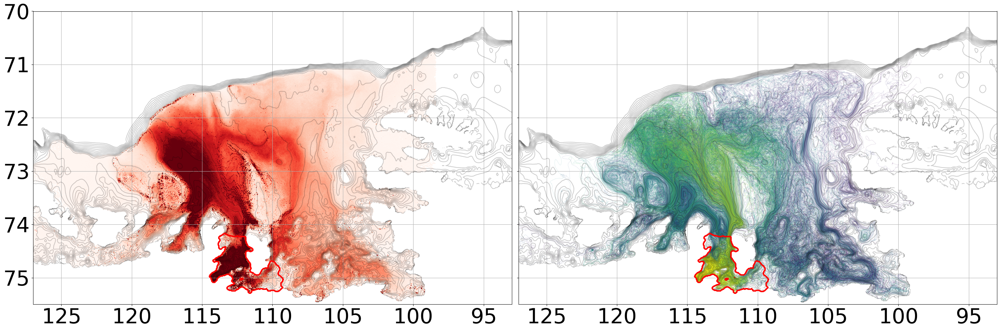

In [60]:
fig, ax = plot(maps[5], CSN_mask, os_index, lons, lats)

plt.savefig('img_pathways/onshelf_kohler.png', dpi=300)

100%|███████████████████████████████████████████████████████| 1000/1000 [00:05<00:00, 168.03it/s]


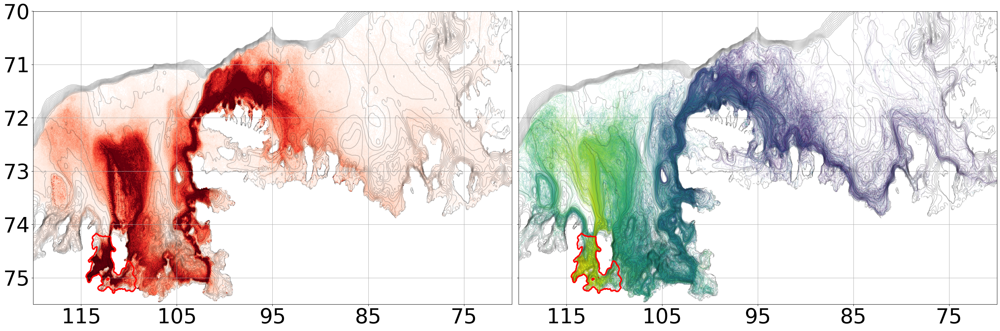

In [61]:
fig, ax = plot(maps[4], CSN_mask, es_index, lons, lats)

for a in ax.flat:
    a.set_xlim(-120, -70)
    a.set_ylim(-75.5, -70)

    a.set_xticks(np.arange(-115, -70, 10))
    a.set_xticklabels(np.arange(115, 70, -10))
    

plt.savefig('img_pathways/eastshelf_kohler.png', dpi=300)

In [62]:
maps = np.load('data_heatmap/smith_3yr_maps.npy', allow_pickle=True)
source = zarr.open('outputs/R8_ASE_5min/smith.zarr', 'r')
lons = source['lon'][:]
lats = source['lat'][:]

In [63]:
os_index, es_index = get_index('processed_dataGL/smith_0d_CS.npy',
                               'processed_dataGL/smith_0d_IS.npy',
                               'processed_dataGL/smith_0d_Eastern.npy')

100%|███████████████████████████████████████████████████████| 1000/1000 [00:06<00:00, 147.97it/s]


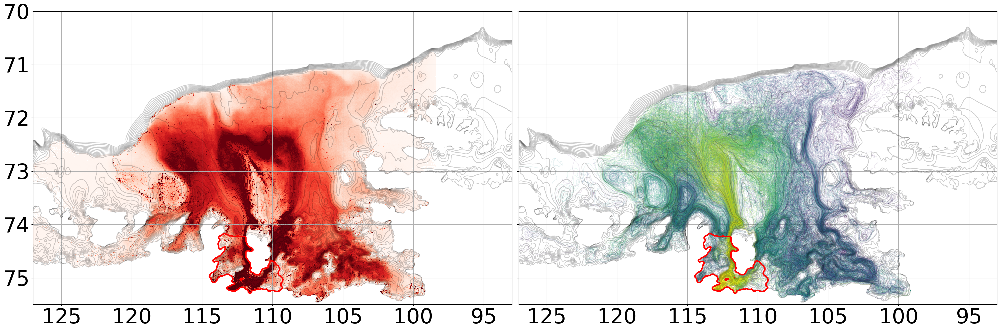

In [64]:
fig, ax = plot(maps[5], CSN_mask, os_index, lons, lats)

plt.savefig('img_pathways/onshelf_smith.png', dpi=300)

100%|███████████████████████████████████████████████████████| 1000/1000 [00:05<00:00, 169.50it/s]


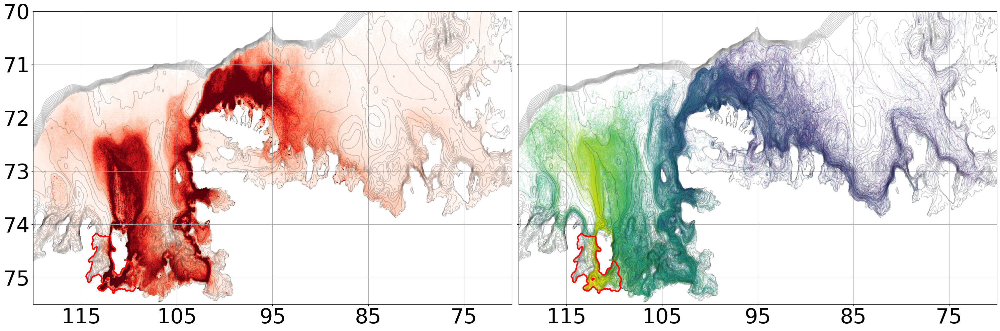

In [65]:
fig, ax = plot(maps[4], CSN_mask, es_index, lons, lats)

for a in ax.flat:
    a.set_xlim(-120, -70)
    a.set_ylim(-75.5, -70)

    a.set_xticks(np.arange(-115, -70, 10))
    a.set_xticklabels(np.arange(115, 70, -10))
    

plt.savefig('img_pathways/eastshelf_smith.png', dpi=300)

In [66]:
maps = np.load('data_heatmap/thwaites_3yr_maps.npy', allow_pickle=True)
source = zarr.open('outputs/R8_ASE_5min/thwaites.zarr', 'r')
lons = source['lon'][:]
lats = source['lat'][:]

In [67]:
os_index, es_index = get_index('processed_dataGL/thwaites_0d_CS.npy',
                               'processed_dataGL/thwaites_0d_IS.npy',
                               'processed_dataGL/thwaites_0d_Eastern.npy')

100%|███████████████████████████████████████████████████████| 1000/1000 [00:06<00:00, 147.96it/s]


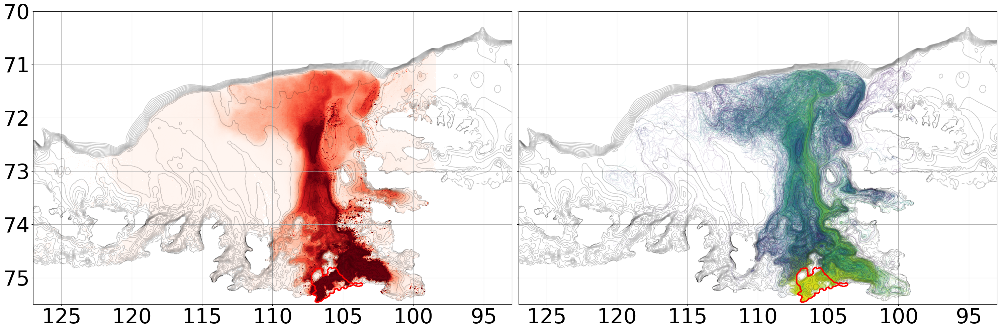

In [68]:
fig, ax = plot(maps[5], TIS_mask, os_index, lons, lats)

plt.savefig('img_pathways/onshelf_thwaites.png', dpi=300)

100%|███████████████████████████████████████████████████████| 1000/1000 [00:05<00:00, 174.13it/s]


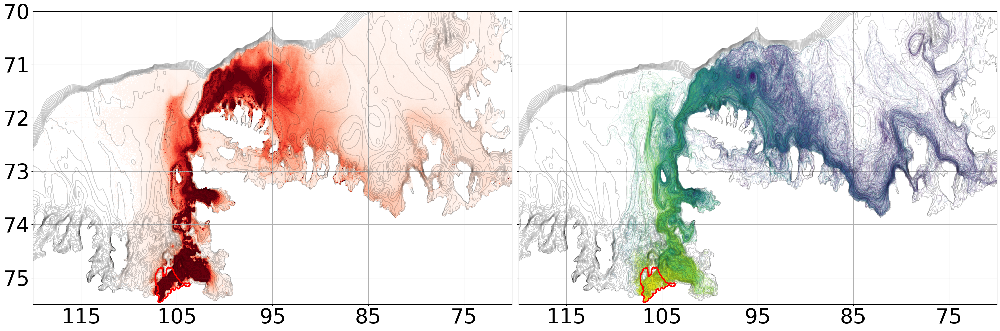

In [69]:
fig, ax = plot(maps[4], TIS_mask, es_index, lons, lats)

for a in ax.flat:
    a.set_xlim(-120, -70)
    a.set_ylim(-75.5, -70)

    a.set_xticks(np.arange(-115, -70, 10))
    a.set_xticklabels(np.arange(115, 70, -10))
    
plt.savefig('img_pathways/eastshelf_thwaites.png', dpi=300)

In [70]:
maps = np.load('data_heatmap/pineisland_3yr_maps.npy', allow_pickle=True)
source = zarr.open('outputs/R8_ASE_5min/pineisland.zarr', 'r')
lons = source['lon'][:]
lats = source['lat'][:]

In [73]:
os_index, es_index = get_index('processed_dataGL/pineisland_0d_CS.npy',
                               'processed_dataGL/pineisland_0d_IS.npy',
                               'processed_dataGL/pineisland_0d_Eastern.npy')

100%|███████████████████████████████████████████████████████| 1000/1000 [00:06<00:00, 142.94it/s]


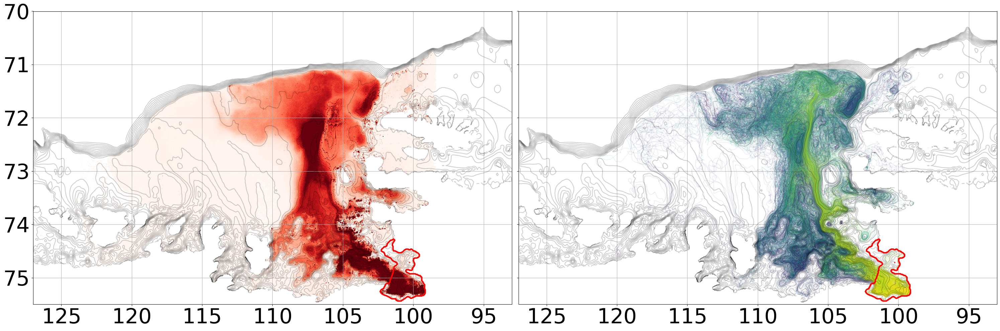

In [74]:
fig, ax = plot(maps[5], PIG_mask, os_index, lons, lats)

plt.savefig('img_pathways/onshelf_pineisland.png', dpi=300)

100%|███████████████████████████████████████████████████████| 1000/1000 [00:05<00:00, 179.35it/s]


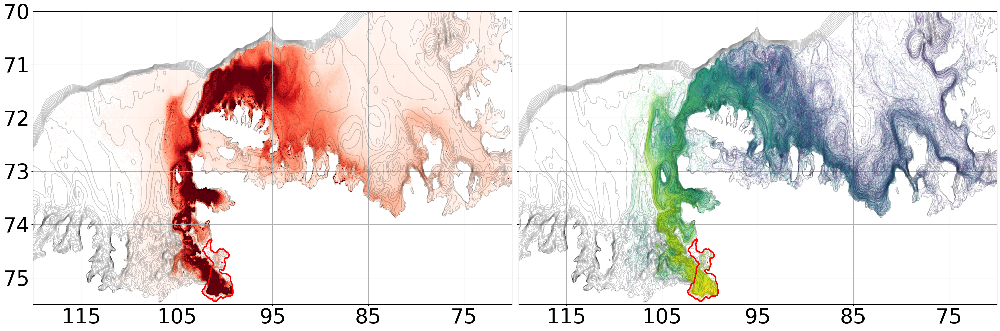

In [75]:
fig, ax = plot(maps[4], PIG_mask, es_index, lons, lats)

for a in ax.flat:
    a.set_xlim(-120, -70)
    a.set_ylim(-75.5, -70)

    a.set_xticks(np.arange(-115, -70, 10))
    a.set_xticklabels(np.arange(115, 70, -10))
    
    
plt.savefig('img_pathways/eastshelf_pineisland.png', dpi=300)

## Make cbar

In [55]:
sample =np.zeros((100,100))

count = 0
for i in range(100):
    for j in range(100):
        sample[i,j] = count
        count += 0.0001

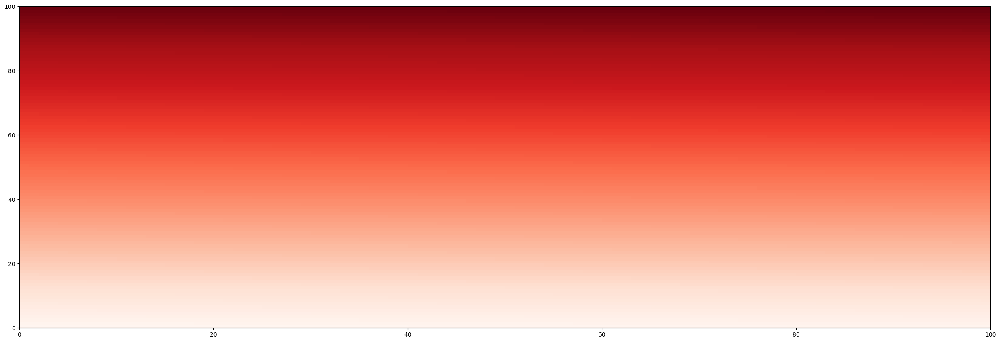

In [56]:
fig, ax = plt.subplots(figsize=(30,10))
im = ax.pcolormesh(sample, vmin = 0, vmax=1, cmap='Reds')

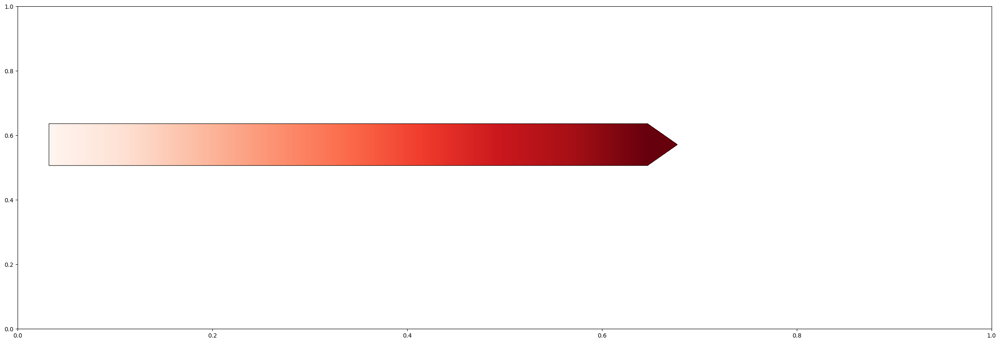

In [57]:
fig, ax = plt.subplots(figsize=(30,10))

cbar_ax = fig.add_axes([0.15, 0.5, 0.5, 0.1])
cbar = fig.colorbar(im, cax=cbar_ax,orientation='horizontal', extend='max')
cbar.ax.set_xlabel(f'', size=20)
cbar.ax.tick_params(labelsize=80)

cbar.ax.set_xticks([])

# cbar.ax.set_xticklabels([0.01, 0.99])


# cbar.ax.set_xlabel('Normalized probability distribution', fontsize=50)
cbar.ax.xaxis.set_label_position('top') 

plt.savefig('img_pathways/cbar_Reds.png', dpi=300)